# Urban_Eye - IA para classificar problemas urbanos

## Importações

In [20]:
import os

import numpy as np
import pandas as pd

import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import tensorflow.keras as keras

from sklearn.metrics import confusion_matrix, roc_curve, auc

from sklearn.utils.class_weight import compute_class_weight

from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import MobileNetV2

from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Sequential, load_model

from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, CSVLogger

from itertools import cycle

## Análise Exploratória de Dados (EDA)

In [21]:
classes = os.listdir("/kaggle/input/urban-issues-dataset")
classes.remove("config.yaml")
print(classes)

for item in classes:

    print(f"Verificando {item}: ")

    usual_path = os.path.join("/kaggle/input/urban-issues-dataset/", item, item)

    train = len(os.listdir(usual_path + "/train/images"))
    test = len(os.listdir(usual_path + "/test/images"))
    valid = len(os.listdir(usual_path + "/valid/images"))

    print(f"Images: Train: {train} | Test: {test} | Valid:  {valid}")

['FallenTrees', 'DamagedElectricalPoles', 'DamagedRoadSigns', 'IllegalParking', 'Graffitti', 'Potholes and RoadCracks', 'Garbage', 'Damaged concrete structures', 'DeadAnimalsPollution']
Verificando FallenTrees: 
Images: Train: 8500 | Test: 1632 | Valid:  982
Verificando DamagedElectricalPoles: 
Images: Train: 7271 | Test: 328 | Valid:  513
Verificando DamagedRoadSigns: 
Images: Train: 2267 | Test: 39 | Valid:  43
Verificando IllegalParking: 
Images: Train: 57 | Test: 7 | Valid:  3
Verificando Graffitti: 
Images: Train: 1704 | Test: 210 | Valid:  214
Verificando Potholes and RoadCracks: 
Images: Train: 5667 | Test: 369 | Valid:  1219
Verificando Garbage: 
Images: Train: 3133 | Test: 337 | Valid:  660
Verificando Damaged concrete structures: 
Images: Train: 9315 | Test: 1222 | Valid:  1228
Verificando DeadAnimalsPollution: 
Images: Train: 172 | Test: 16 | Valid:  32


In [22]:
# Pastas
splits = ['train', 'test', 'valid']

# Dicionario para salvar no df
img_data_list = []

for classe in classes:
    for split in splits:

        usual_path = os.path.join("/kaggle/input/urban-issues-dataset", classe, classe, split + "/images/")

        try:

            file_names = os.listdir(usual_path)

            for file_name in file_names:

                path = os.path.join(usual_path, file_name)
            
                img_data_list.append({
    
                    'file_path': path,
                    'split'    : split,
                    'label'    : classe
                    
                })

        except Exception as e:

            print(f"Erro: {e}")

df_raw = pd.DataFrame(img_data_list)
print(df_raw.info())
print(df_raw.head(5))
print(df_raw.tail(5))
print(df_raw['label'].value_counts())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47140 entries, 0 to 47139
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_path  47140 non-null  object
 1   split      47140 non-null  object
 2   label      47140 non-null  object
dtypes: object(3)
memory usage: 1.1+ MB
None
                                           file_path  split        label
0  /kaggle/input/urban-issues-dataset/FallenTrees...  train  FallenTrees
1  /kaggle/input/urban-issues-dataset/FallenTrees...  train  FallenTrees
2  /kaggle/input/urban-issues-dataset/FallenTrees...  train  FallenTrees
3  /kaggle/input/urban-issues-dataset/FallenTrees...  train  FallenTrees
4  /kaggle/input/urban-issues-dataset/FallenTrees...  train  FallenTrees
                                               file_path  split  \
47135  /kaggle/input/urban-issues-dataset/DeadAnimals...  valid   
47136  /kaggle/input/urban-issues-dataset/DeadAnimals...  valid   
47137  /kaggl

In [23]:
# Divisão das classes

df_train = df_raw[df_raw['split'] == 'train']
df_valid = df_raw[df_raw['split'] == 'valid']

print( df_train.info() )
print( df_valid.info() )


df_test  = df_raw[df_raw['split'] == 'test']
print( df_test.info() )

<class 'pandas.core.frame.DataFrame'>
Index: 38086 entries, 0 to 47091
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_path  38086 non-null  object
 1   split      38086 non-null  object
 2   label      38086 non-null  object
dtypes: object(3)
memory usage: 1.2+ MB
None
<class 'pandas.core.frame.DataFrame'>
Index: 4894 entries, 10132 to 47139
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_path  4894 non-null   object
 1   split      4894 non-null   object
 2   label      4894 non-null   object
dtypes: object(3)
memory usage: 152.9+ KB
None
<class 'pandas.core.frame.DataFrame'>
Index: 4160 entries, 8500 to 47107
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_path  4160 non-null   object
 1   split      4160 non-null   object
 2   label      4160 non-null   object
dtypes: o

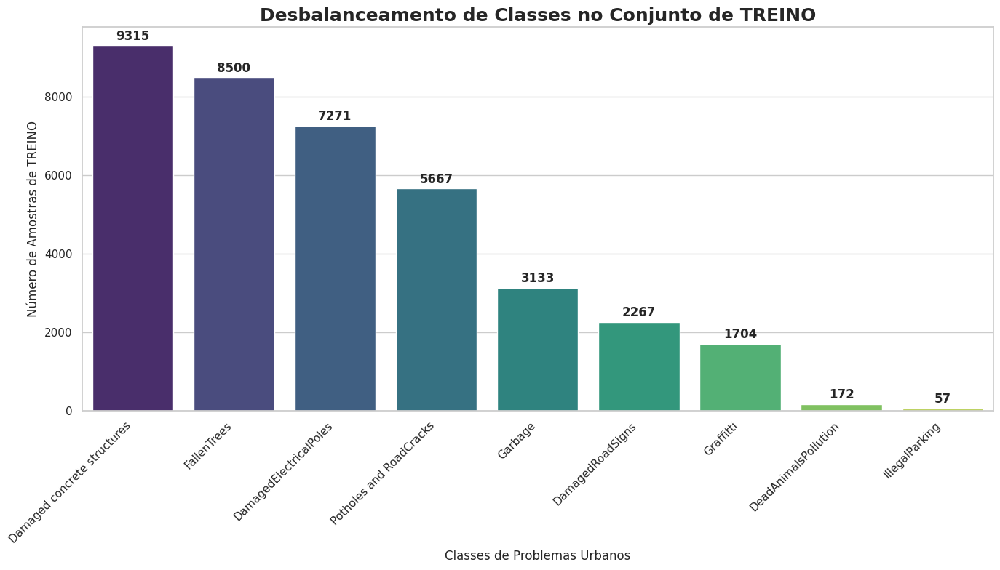

In [24]:
#Graficos Desbalanceamento das classes

plt.figure(figsize=(14, 8))
sns.set_theme(style="whitegrid")

ax = sns.countplot(
    x = 'label', 
    data = df_train, 
    order = df_train['label'].value_counts().index, # Ordena as barras
    palette = 'viridis'
)

plt.title('Desbalanceamento de Classes no Conjunto de TREINO', fontsize=18, weight='bold')
plt.xlabel('Classes de Problemas Urbanos', fontsize=12)
plt.ylabel('Número de Amostras de TREINO', fontsize=12)

plt.xticks(rotation=45, ha='right', fontsize=11)

# Adicionar os números no topo das barras
for p in ax.patches:
    
    ax.annotate(f'{int(p.get_height())}', # O número (como inteiro)
                
                (p.get_x() + p.get_width() / 2., p.get_height()), # Posição
                
                ha = 'center', va = 'center', 
                xytext = (0, 9), 
                textcoords = 'offset points',
                weight='bold')

plt.tight_layout()
plt.savefig('class_distribution.png')
plt.show()

<class 'pandas.core.frame.DataFrame'>
Index: 63 entries, 38202 to 27031
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_path  63 non-null     object
 1   split      63 non-null     object
 2   label      63 non-null     object
dtypes: object(3)
memory usage: 2.0+ KB
None


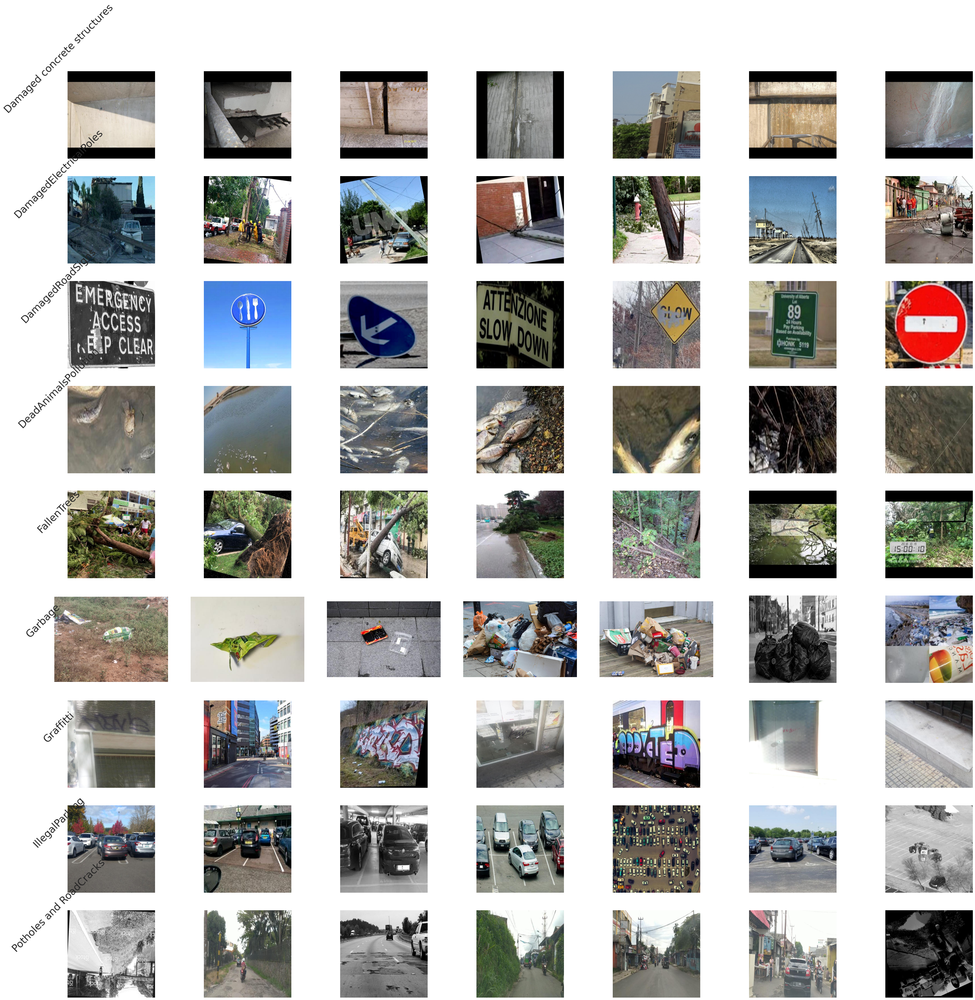

In [25]:
# Uma análise mais exploratória, algo como o "sanity test"

n_samples = 7

df_samples = df_raw.groupby('label').sample( n_samples, replace = False )

print(df_samples.info())

fig, axes = plt.subplots(nrows = 9, ncols = n_samples, figsize = (50, 50))

labels = sorted( df_samples['label'].unique() )

for i, label in enumerate( labels ):

    class_samples = df_samples[df_samples['label'] == label]['file_path']
    
    for j, file_path in enumerate(class_samples):

        try: 

            img = mpimg.imread(file_path)
    
            axes[i, j].imshow(img)
            axes[i, j].axis('off')
    
            if j == 0:
    
                axes[i, j].set_title(label, rotation = 45, x = -0.1, y = 0.5, fontsize = 30)
    
        except Exception as e:
            
            axes[i, j].axis('off')
            print(f"Erro: {e}")

# plt.tight_layout()
plt.show()

## Pré-processamento

In [26]:
# Tamnaho padrão de cada img e do lote
img_width, img_height = 224, 224
img_size = (img_width, img_height)

batch_size = 64

# Gerador do treino com data augmentation
train_gen_data = ImageDataGenerator(

    rescale = 1./255,              # Normalização dos pixels
    horizontal_flip = True,        # flip horizontal nas imgs permitido
    rotation_range = 20,           # Cria rotações na img
    zoom_range = 0.15,             # cria zooms na img
    width_shift_range = 0.1,       # desliza um pouco as imgs
    height_shift_range = 0.1,
    shear_range = 0.15,            # Simula perspectiva
    brightness_range = [0.8, 1.2], # Mexe no brilho
    fill_mode = 'nearest'          # Preenche pixels novos
    
)

valid_gen_data = ImageDataGenerator(

    rescale = 1./255  # Apenas normaliza
    
)

train_gen = train_gen_data.flow_from_dataframe(

    dataframe = df_train,
    x_col = 'file_path',
    y_col = 'label',
    target_size = img_size,
    batch_size = batch_size,
    class_model = 'categorical', # Transforma os rótulos em "one-hot encoding"
    shuffle = True               # Embaralha os dados de treino a cada "época"
    
)

valid_gen = valid_gen_data.flow_from_dataframe(

    dataframe = df_valid,
    x_col = 'file_path',
    y_col = 'label',
    target_size = img_size,
    batch_size = batch_size,
    class_model = 'categorical',
    shuffle = False
    
)

# Uso de valid_gen_data pois ele só reescala, evitamos redundancia
test_gen = valid_gen_data.flow_from_dataframe(

    dataframe = df_test,
    x_col = 'file_path',
    y_col = 'label',
    target_size = img_size,
    batch_size = batch_size,
    class_model = 'categorical',
    shuffle = False 
    
)

Found 38086 validated image filenames belonging to 9 classes.
Found 4894 validated image filenames belonging to 9 classes.
Found 4160 validated image filenames belonging to 9 classes.


## Setando o modelo e os callbakcs

In [27]:
base_model = MobileNetV2(

    input_shape = ( img_width, img_height, 3 ),
    alpha = 1.0,
    include_top = False, # A camada final (classificação do modelo original) não importa
    weights = "imagenet",
    input_tensor = None,
    pooling = None,
    # classes = len( df_raw['label'].unique() ),  # É ignorando com include_top = False 
    # classifier_activation = 'softmax'           # É ignorando com include_top = False
)

base_model.trainable = False # Congela o modelo base

qtd_classes = len( df_raw['label'].unique() )

model = Sequential([

    base_model,               # O corpo do modelo
    GlobalAveragePooling2D(), # Achata a saída do modelo
    Dropout(0.5),            # Desliga 50% dos neuronios aleatoriamente
    Dense( qtd_classes, activation = 'softmax' )
    
])

In [28]:
model.summary() # O resumo do modelo

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 9)              │        11,529 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,269,513 (8.66 MB)

 Trainable params: 11,529 (45.04 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [29]:
model.compile(

    optimizer = 'adam',                # Teste inicial com Adam por ser mais robusto
    loss = 'categorical_crossentropy', # Pois usaremos 9 classes diferentes
    metrics = [ keras.metrics.Accuracy( name = 'accuracy' ),  # Várias métricas para ajudar no treinamento
                keras.metrics.Precision( name = 'precision' ),
                keras.metrics.Recall( name = 'recall' ),]
    
)

# Peso ou importancia de cada classe na hora do treinamento
class_weights_array = compute_class_weight(

    class_weight = "balanced",              # Estratégia pra cuidar da classe desbalanceada
    classes = np.unique(df_train['label']), # classes únicas do treino
    y = df_train['label']                   # lista completa de rótulos

)

print(np.unique(df_train['label']))

class_weight_dict = dict( enumerate(class_weights_array) )
print(class_weight_dict)

['Damaged concrete structures' 'DamagedElectricalPoles' 'DamagedRoadSigns'
 'DeadAnimalsPollution' 'FallenTrees' 'Garbage' 'Graffitti'
 'IllegalParking' 'Potholes and RoadCracks']
{0: 0.45429713126975607, 1: 0.5820076712663702, 2: 1.8666862716267216, 3: 24.603359173126616, 4: 0.4978562091503268, 5: 1.3507110685533923, 6: 2.4834376630151276, 7: 74.24171539961014, 8: 0.7467403878203243}


In [30]:
checkpoint_callback = ModelCheckpoint(

    filepath = 'bestmodel.keras',
    monitor = 'val_loss',        # Métrica de atenção
    save_best_only = True,
    mode = 'min',                # val_loss minimo
    verbose = 1,                 # Avisa quando salvar o melhor modelo

)

early_stopping_callback = EarlyStopping(

    monitor = 'val_loss',       # Métrica de atenção
    patience = 10,              # Épocas sem melhora para o break
    mode = 'min',               # val_loss minimo
    verbose = 1,
    restore_best_weights = True # Garante a volta dos melhores pesos
    
)

csv_logger = CSVLogger('training_log.csv')

callbacks_list = [checkpoint_callback, early_stopping_callback, csv_logger]

## Treinando o modelo
Descomente essa parte para fazer treinar um novo modelo. Vou deixar comentado e subir o modelo que já treinei e testar direto por ser mais simples.

In [31]:
'''
EPOCHS = 50

history = model.fit(

    train_gen,
    epochs = EPOCHS,
    validation_data = valid_gen,
    class_weight = class_weight_dict,
    callbacks = callbacks_list
    
)

print("Fim do treino")
'''

'\nEPOCHS = 50\n\nhistory = model.fit(\n\n    train_gen,\n    epochs = EPOCHS,\n    validation_data = valid_gen,\n    class_weight = class_weight_dict,\n    callbacks = callbacks_list\n    \n)\n\nprint("Fim do treino")\n'

## Carregando e testando o modelo

In [32]:
# Nesse caso eu fiz o upload do modelo que está na "versão 2 - 50 épocas" deste trabalho
best_model = load_model('//kaggle/input/results-kaggle-version2/keras/default/1/bestmodel.keras')

In [33]:
results = best_model.evaluate(test_gen)

print("--- Resultados para o test")
print(f"* Perda (Loss): {results[0]:.4f}")
print(f"* Acurácia (Accuracy): {results[1]:.4f}")
print(f"* Precisão (Precision): {results[2]:.4f}")
print(f"* Recall (Recall): {results[3]:.4f}")

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


65/65 ━━━━━━━━━━━━━━━━━━━━ 32s 432ms/step - accuracy: 4.3514e-05 - loss: 0.3247 - precision: 0.9062 - recall: 0.8739
--- Resultados para o test
* Perda (Loss): 0.3509
* Acurácia (Accuracy): 0.0001
* Precisão (Precision): 0.9010
* Recall (Recall): 0.8752


## Resultados e gráficos legais

In [34]:
# Pre´-configuração dos gráficos

y_pred_probs = best_model.predict(test_gen)       # Faz o predict do modelo

y_pred_classes = np.argmax(y_pred_probs, axis=1)  # Converte as probabilidades para classes (índices Top-1) [0.1, 0.8, 0.1] -> 1
y_true_classes = test_gen.classes                 # As classes reais (índices) do gerador
class_names = list(test_gen.class_indices.keys()) # Os nomes das classes (para os eixos do gráfico)

y_true_one_hot = to_categorical(y_true_classes, num_classes=len(class_names)) # Converte as classes reais para o formato one-hot (pro ROC) 1 -> [0, 1, 0, 0, 0, 0, 0, 0, 0]

65/65 ━━━━━━━━━━━━━━━━━━━━ 30s 410ms/step


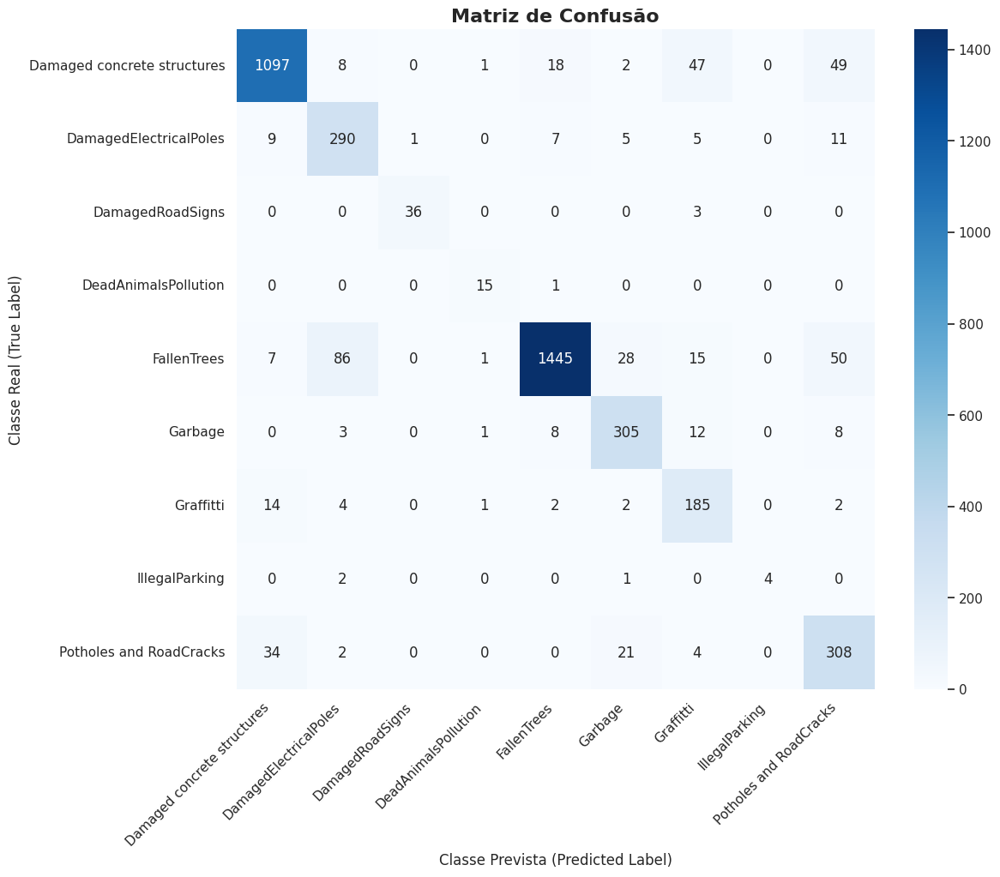

In [35]:
# Matriz de Confusão

cm = confusion_matrix(y_true_classes, y_pred_classes)

plt.figure(figsize=(12, 10))

sns.heatmap(
    cm, 
    annot=True, 
    fmt='d', 
    cmap='Blues', 
    xticklabels=class_names, 
    yticklabels=class_names
)

plt.title('Matriz de Confusão', fontsize=16, weight='bold')
plt.ylabel('Classe Real (True Label)', fontsize=12)
plt.xlabel('Classe Prevista (Predicted Label)', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)

plt.savefig('matriz_de_confusao.png', bbox_inches='tight')
plt.show()

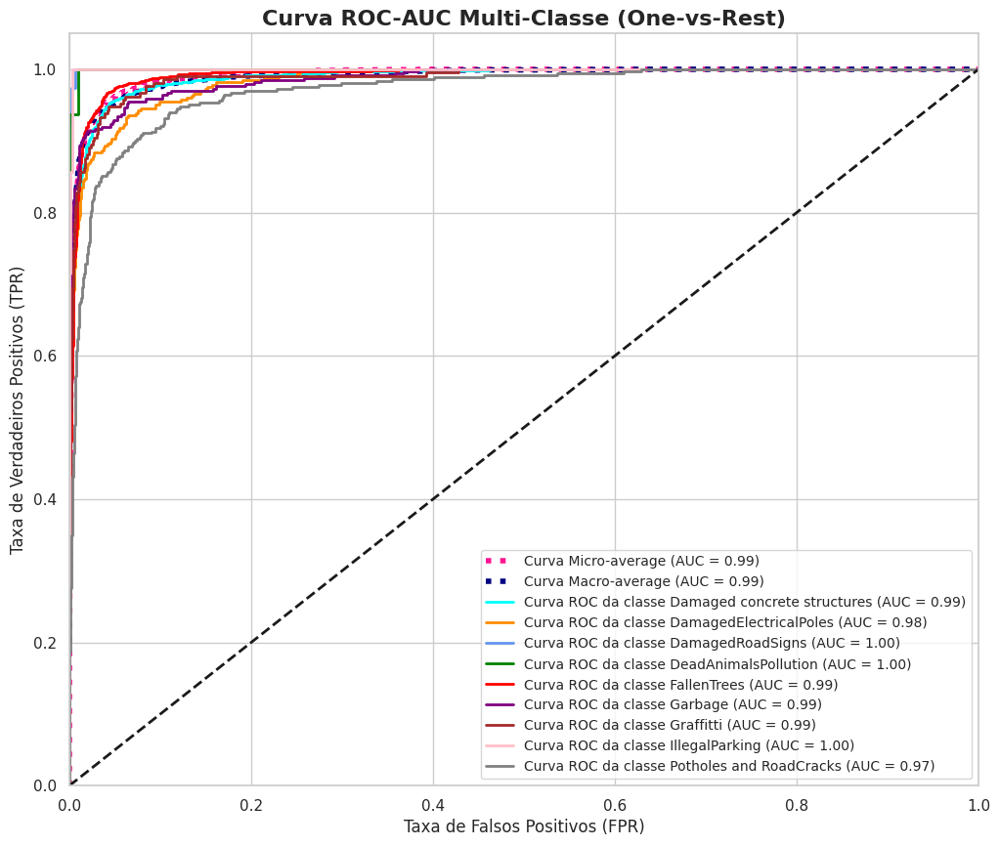

In [36]:
# Curva ROC - AUC

n_classes = len( class_names )

# Dicionário para guardar as curvas de cada classe
fpr = dict()
tpr = dict()
roc_auc = dict()

# Curva ROC e AUC para cada classe (One-vs-Rest)
for i in range(n_classes):
    
    fpr[i], tpr[i], _ = roc_curve(y_true_one_hot[:, i], y_pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Curva ROC "Micro-average" (Agrega todos os verdadeiros e falsos positivos)
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_one_hot.ravel(), y_pred_probs.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Calcular a "Macro-average"
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
mean_tpr = np.zeros_like(all_fpr)

for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    
mean_tpr /= n_classes # Tira a média

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Gráfico
plt.figure(figsize=(12, 10))

# Curva Micro-average
plt.plot(fpr["micro"], tpr["micro"],
         label=f'Curva Micro-average (AUC = {roc_auc["micro"]:.2f})',
         color='deeppink', linestyle=':', linewidth=4)

# Curva Macro-average
plt.plot(fpr["macro"], tpr["macro"],
         label=f'Curva Macro-average (AUC = {roc_auc["macro"]:.2f})',
         color='navy', linestyle=':', linewidth=4)

# Curvas de cada classe (individual)
colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'green', 'red', 'purple', 'brown', 'pink', 'gray'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Curva ROC da classe {class_names[i]} (AUC = {roc_auc[i]:.2f})')

# Linha padrão da AUC = 0.5
plt.plot([0, 1], [0, 1], 'k--', lw=2)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Taxa de Falsos Positivos (FPR)', fontsize=12)
plt.ylabel('Taxa de Verdadeiros Positivos (TPR)', fontsize=12)
plt.title('Curva ROC-AUC Multi-Classe (One-vs-Rest)', fontsize=16, weight='bold')
plt.legend(loc="lower right", fontsize='small')

plt.savefig('curva_roc_auc.png', bbox_inches='tight') # Salva a figura
plt.show()

## Um teste mais prático e próximo com o conjunto de Teste!

Nomes das classes: ['Damaged concrete structures', 'DamagedElectricalPoles', 'DamagedRoadSigns', 'DeadAnimalsPollution', 'FallenTrees', 'Garbage', 'Graffitti', 'IllegalParking', 'Potholes and RoadCracks']

########################################
Teste - Imagem 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/FallenTrees/FallenTrees/test/images/475_jpg.rf.ca0f7d195e191788462c2188483ac0dc.jpg
Classe REAL: FallenTrees
Classe PREVISTA (Top-1): FallenTrees
Confiança (Top-1): 85.75%

--- Análise Top 3 ---
  1. FallenTrees: 85.75%
  2. DamagedElectricalPoles: 13.43%
  3. Graffitti: 0.76%




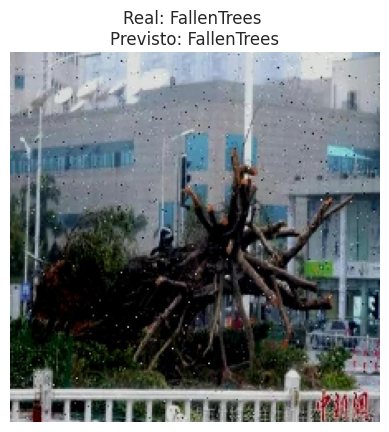






########################################
Teste - Imagem 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/FallenTrees/FallenTrees/test/images/20210928_162030_jpg.rf.2e3173c7a7ee9849d1f5d78369dc7fed.jpg
Classe REAL: FallenTrees
Classe PREVISTA (Top-1): FallenTrees
Confiança (Top-1): 99.79%

--- Análise Top 3 ---
  1. FallenTrees: 99.79%
  2. Damaged concrete structures: 0.10%
  3. Potholes and RoadCracks: 0.04%




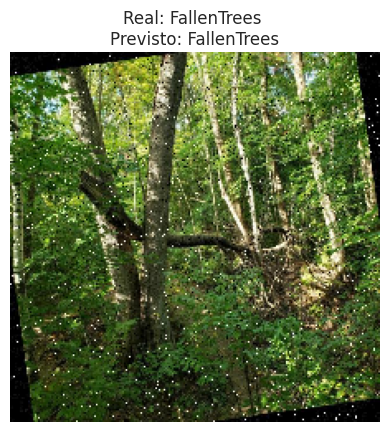






########################################
Teste - Imagem 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/Damaged concrete structures/Damaged concrete structures/test/images/dacl10k_v2_train_4414_jpg.rf.ea05a2dffa36396b67a837886df3d9c3.jpg
Classe REAL: Damaged concrete structures
Classe PREVISTA (Top-1): Damaged concrete structures
Confiança (Top-1): 98.46%

--- Análise Top 3 ---
  1. Damaged concrete structures: 98.46%
  2. Graffitti: 1.33%
  3. Potholes and RoadCracks: 0.10%




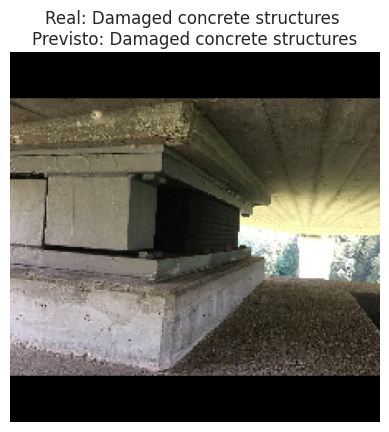






########################################
Teste - Imagem 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/FallenTrees/FallenTrees/test/images/3881_jpg.rf.ce8cf38be90672d183b34e201424d61a.jpg
Classe REAL: FallenTrees
Classe PREVISTA (Top-1): FallenTrees
Confiança (Top-1): 99.94%

--- Análise Top 3 ---
  1. FallenTrees: 99.94%
  2. Garbage: 0.03%
  3. DamagedElectricalPoles: 0.03%




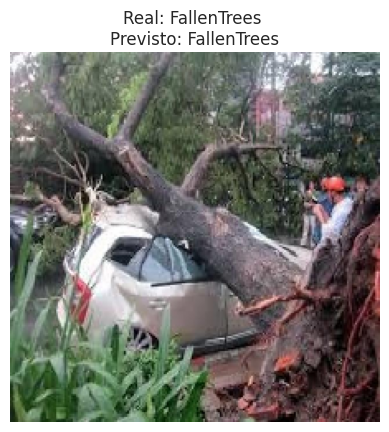






########################################
Teste - Imagem 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/Garbage/Garbage/test/images/img3557_jpg.rf.ca6a81c2c98f323276c609fff31ae17a.jpg
Classe REAL: Garbage
Classe PREVISTA (Top-1): Garbage
Confiança (Top-1): 93.14%

--- Análise Top 3 ---
  1. Garbage: 93.14%
  2. Graffitti: 3.85%
  3. Potholes and RoadCracks: 2.80%




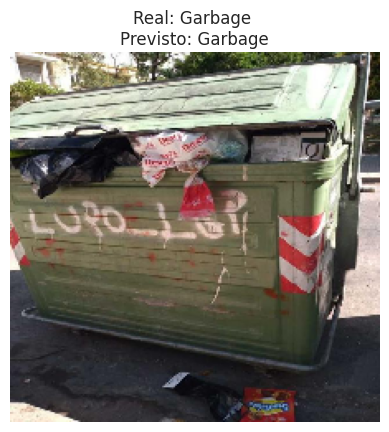






########################################
Teste - Imagem 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/FallenTrees/FallenTrees/test/images/275_jpg.rf.7c10ddb517b5a711028b123a9450b97f.jpg
Classe REAL: FallenTrees
Classe PREVISTA (Top-1): FallenTrees
Confiança (Top-1): 98.49%

--- Análise Top 3 ---
  1. FallenTrees: 98.49%
  2. DamagedElectricalPoles: 1.43%
  3. Garbage: 0.06%




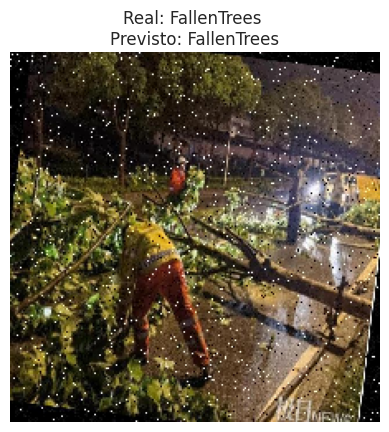






########################################
Teste - Imagem 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/Garbage/Garbage/test/images/rifiuti-incendi-vigili-del-fuoco_jpg.rf.8f193c6c47ff9a8e1eae3d801d5cb75a.jpg
Classe REAL: Garbage
Classe PREVISTA (Top-1): Garbage
Confiança (Top-1): 99.99%

--- Análise Top 3 ---
  1. Garbage: 99.99%
  2. Graffitti: 0.01%
  3. FallenTrees: 0.00%




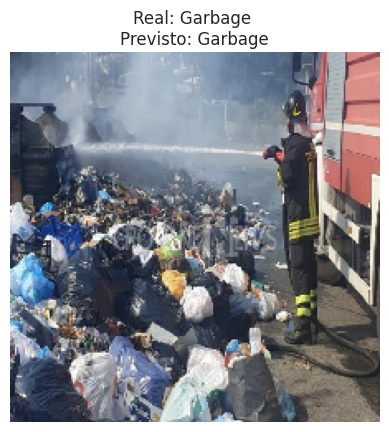






########################################
Teste - Imagem 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/Potholes and RoadCracks/Potholes and RoadCracks/test/images/482_jpg.rf.7b955c23512860b9245499c11644476b.jpg
Classe REAL: Potholes and RoadCracks
Classe PREVISTA (Top-1): Potholes and RoadCracks
Confiança (Top-1): 98.35%

--- Análise Top 3 ---
  1. Potholes and RoadCracks: 98.35%
  2. Damaged concrete structures: 1.63%
  3. Garbage: 0.01%




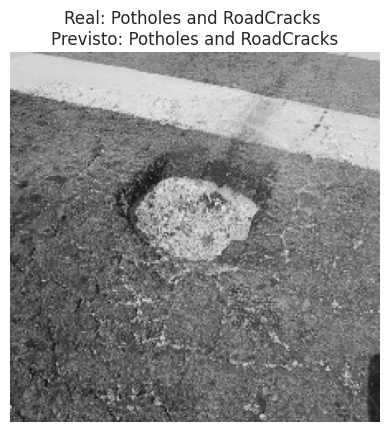






########################################
Teste - Imagem 9/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/Potholes and RoadCracks/Potholes and RoadCracks/test/images/206_jpg.rf.7a13cf4c45726dc890393a7c6b08241e.jpg
Classe REAL: Potholes and RoadCracks
Classe PREVISTA (Top-1): Potholes and RoadCracks
Confiança (Top-1): 99.51%

--- Análise Top 3 ---
  1. Potholes and RoadCracks: 99.51%
  2. Garbage: 0.26%
  3. Graffitti: 0.19%




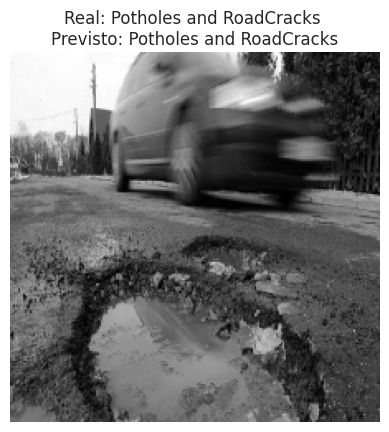






########################################
Teste - Imagem 10/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Imagem de Teste: /kaggle/input/urban-issues-dataset/Damaged concrete structures/Damaged concrete structures/test/images/dacl10k_v2_train_4109_jpg.rf.c8841db7945e9088ab04565edb42f6c0.jpg
Classe REAL: Damaged concrete structures
Classe PREVISTA (Top-1): Damaged concrete structures
Confiança (Top-1): 97.84%

--- Análise Top 3 ---
  1. Damaged concrete structures: 97.84%
  2. Graffitti: 1.44%
  3. FallenTrees: 0.59%




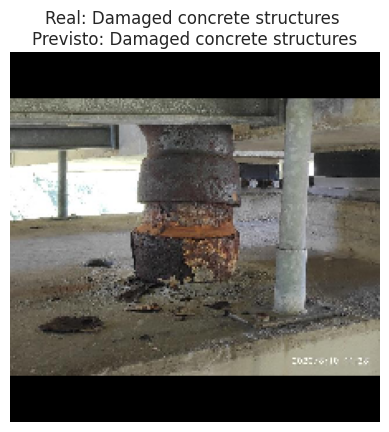

In [39]:
# Testar com Imagens Aleatórias

class_names = list(train_gen.class_indices.keys())
print(f"Nomes das classes: {class_names}")

# Carregar, pré-processar e prever uma imagem
def predict_one_image(filepath, model_to_use, k=3):

    img = image.load_img(filepath, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array_scaled = img_array * 1./255
    img_batch = np.expand_dims(img_array_scaled, axis=0)
    
    prediction_array = model_to_use.predict(img_batch)[0] # Pega o primeiro (e único) item do lote
    
    # Pega os K índices de topo (do menor para o maior)
    top_k_indices = np.argsort(prediction_array)[-k:][::-1]
    
    # Usa os índices para buscar os nomes das classes e as confianças
    top_k_classes = [class_names[i] for i in top_k_indices]
    top_k_confidences = prediction_array[top_k_indices]
    
    return top_k_classes, top_k_confidences, img

qtd = 10
K_TOP = 3 # Top 3 da predição

for i in range(qtd):
    print(f"\n" + "#" * 40)
    print(f"Teste - Imagem {i+1}/{qtd}")
    
    # Imagem aleatória do DataFrame de teste
    sample_image_row = df_test.sample(1).iloc[0]
    sample_path = sample_image_row['file_path'] # Usando 'file_path' como no seu código
    real_label = sample_image_row['label']
    
    # Previsão
    top_classes, top_confidences, img = predict_one_image(sample_path, best_model, k=K_TOP)
    
    # O Top1
    predicted_class_top1 = top_classes[0]
    confidence_top1 = top_confidences[0]

    print(f"Imagem de Teste: {sample_path}")
    print(f"Classe REAL: {real_label}")
    print(f"Classe PREVISTA (Top-1): {predicted_class_top1}")
    print(f"Confiança (Top-1): {confidence_top1*100:.2f}%")
    
    # Mostra a lista Top-3
    print("\n--- Análise Top 3 ---")
    for j in range(K_TOP):
        print(f"  {j+1}. {top_classes[j]}: {top_confidences[j]*100:.2f}%")

    print("\n")
    # Mostra a imagem
    plt.imshow(img)
    plt.title(f"Real: {real_label} \nPrevisto: {predicted_class_top1}")
    plt.axis('off')
    plt.show()
    
    print(f"\n\n\n")